In [44]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('fivethirtyeight')
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
from dataprep.eda import *
import geopandas as gpd

In [45]:
df = pd.read_excel('data_siap.xlsx')
print(df)

     tahun        provinsi  pengangguran      ump
0     2008            ACEH      163868.0  1000000
1     2009            ACEH      173624.0  1200000
2     2010            ACEH      166275.0  1300000
3     2011            ACEH      178020.0  1350000
4     2012            ACEH      165707.0  1400000
..     ...             ...           ...      ...
393   2015  SUMATERA UTARA      421232.0  1625000
394   2016  SUMATERA UTARA      427964.0  1811875
395   2018  SUMATERA UTARA      422921.0  2132189
396   2019  SUMATERA UTARA      434342.0  2303403
397   2020  SUMATERA UTARA      360993.0  2499423

[398 rows x 4 columns]


  0%|          | 0/199 [00:00<?, ?it/s]


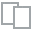
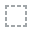
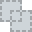
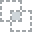
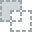
...
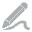
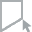
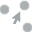
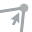
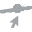

In [46]:
plot(df)

  0%|          | 0/704 [00:00<?, ?it/s]

DataPrep Report
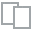
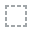
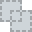
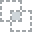
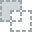
...
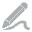
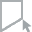
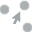
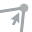
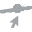

In [47]:
create_report(df)

In [48]:
ma = df.loc[df['tahun'] == 2008, ]
ma1 = ma.iloc[:15, 2]
na = df.loc[df['tahun'] == 2020, ]
na1 = na.iloc[:15, 2]
na1

11      137674.0
23       32986.0
35       25436.0
47      487496.0
59       33896.0
70       74547.0
82      281945.0
94       19709.0
106      76987.0
118    1889925.0
129     795346.0
140     811324.0
152     118533.0
164      83336.0
176      47159.0
Name: pengangguran, dtype: float64

In [49]:
na

,tahun,provinsi,pengangguran,ump
11,2020,ACEH,137674.0,3165031
23,2020,BALI,32986.0,2494000
35,2020,KEPULAUAN BANGKA BELITUNG,25436.0,3230024
47,2020,BANTEN,487496.0,2460997
59,2020,BENGKULU,33896.0,2213604
70,2020,DAERAH ISTIMEWA YOGYAKARTA,74547.0,1704608
82,2020,DKI JAKARTA,281945.0,4276350
94,2020,GORONTALO,19709.0,2788826
106,2020,JAMBI,76987.0,2630162
118,2020,JAWA BARAT,1889925.0,1810351


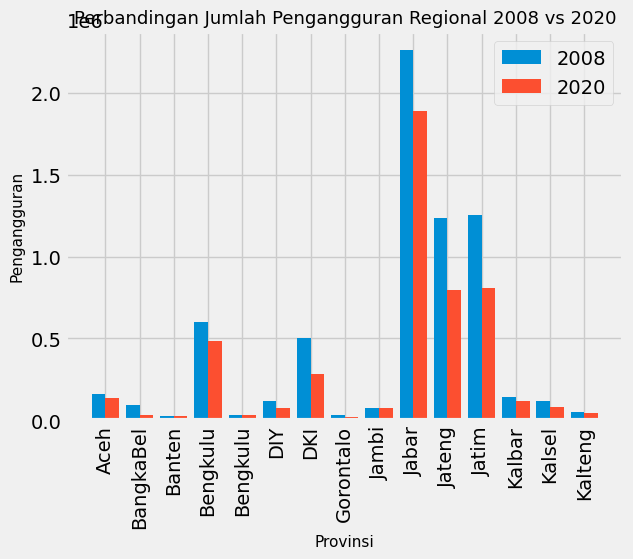

In [50]:
X = ['Aceh', 'BangkaBel', 'Banten', 'Bengkulu', 'Bengkulu', 'DIY', 'DKI', 'Gorontalo', 'Jambi', 'Jabar', 'Jateng', 'Jatim', 'Kalbar', 'Kalsel', 'Kalteng']
ma1
na1
X_axis = np.arange(len(X))

plt.bar(X_axis - 0.2, ma1, 0.4, label = '2008')
plt.bar(X_axis + 0.2, na1, 0.4, label = "2020")

plt.xticks(X_axis, X)
plt.xticks(rotation = 90)
plt.xlabel("Provinsi", fontsize = 11)
plt.ylabel("Pengangguran", fontsize = 11)
plt.title("Perbandingan Jumlah Pengangguran Regional 2008 vs 2020", fontsize = 13, fontname = "Arial Black")
plt.legend()
plt.show()

  0%|          | 0/521 [00:00<?, ?it/s]

DataPrep Report
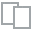
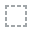
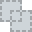
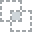
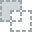
...
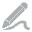
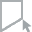
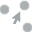
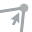
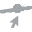

In [51]:
df_n = df.iloc[:, 1:4]
df_n
create_report(df_n)

In [52]:
#data mapping dimasukkan
fp = ("BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shp")
#reading the file stored in variable fp
map_df = gpd.read_file(fp)
# check data type so we can see that this is not a normal dataframe, but a GEOdataframe
map_df

,OBJECTID,PROVINSI,Shape_Leng,Shape_Area,geometry
0,1,ACEH,27.455786,4.625436,"MULTIPOLYGON Z (((97.39178 2.03748 0.00003, 97..."
1,2,BALI,6.026646,0.458717,"MULTIPOLYGON Z (((115.12509 -8.84761 0.00003, ..."
2,3,BANTEN,9.282228,0.764911,"MULTIPOLYGON Z (((105.54977 -6.99566 0.00003, ..."
3,4,BENGKULU,11.706367,1.630129,"MULTIPOLYGON Z (((102.38616 -5.47144 0.00003, ..."
4,5,DAERAH ISTIMEWA YOGYAKARTA,3.342892,0.260130,"MULTIPOLYGON Z (((110.81980 -8.20358 0.00003, ..."
5,6,DKI JAKARTA,3.123689,0.053426,"MULTIPOLYGON Z (((106.87677 -6.10030 0.00003, ..."
6,7,GORONTALO,11.013237,0.977600,"MULTIPOLYGON Z (((121.42536 0.41243 0.00003, 1..."
7,8,JAMBI,11.835072,3.977711,"MULTIPOLYGON Z (((104.40714 -0.86371 0.00003, ..."
8,9,JAWA BARAT,11.614950,3.032785,"MULTIPOLYGON Z (((108.68501 -6.76990 0.00003, ..."
9,10,JAWA TENGAH,15.456349,2.819838,"MULTIPOLYGON Z (((108.88353 -7.74846 0.00003, ..."


<AxesSubplot:>

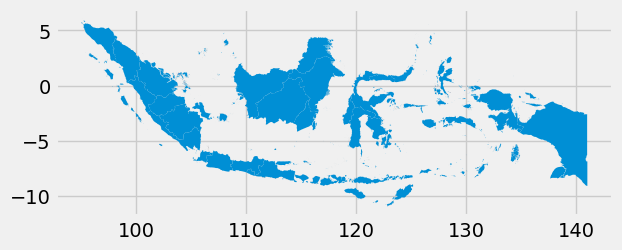

In [53]:
#plotting the map of the shape file preview of the maps without data in it
map_df.plot()

In [54]:
ma_ump = ma.loc[:, ['provinsi', 'ump']]
na_ump = na.loc[:, ['provinsi', 'ump']]

#data_2012
ya = df.loc[df['tahun'] == 2012, ]
ya_ump = ya.loc[:, ['provinsi', 'ump']]
#data 2016
za = df.loc[df['tahun'] == 2016, ]
za_ump = za.loc[:, ['provinsi', 'ump']]

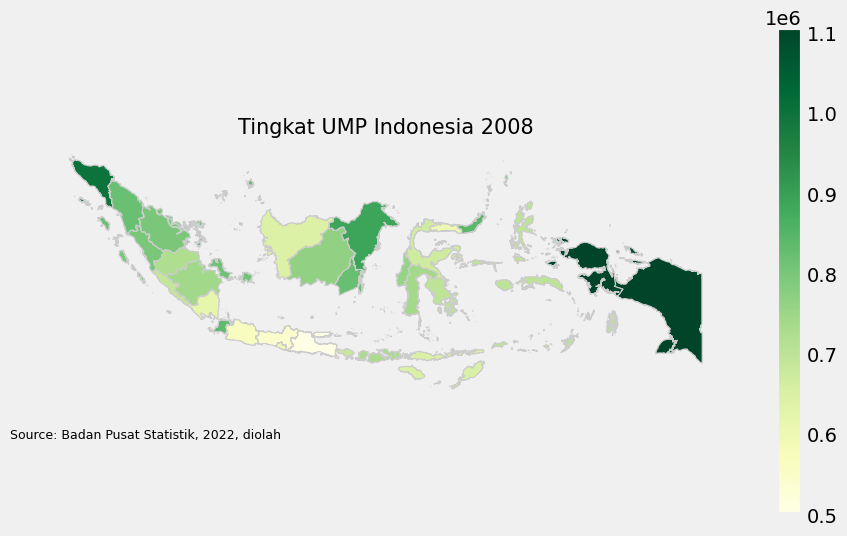

In [55]:
# joining the geodataframe with the cleaned up csv dataframe
merged = map_df.set_index('PROVINSI').join(ma_ump.set_index('provinsi'))
#.head() returns the top 5(by default ) lines of the dataframe
merged.head()
# set a variable that will call whatever column we want to visualise on the map
variable = 'ump'
# set the range for the choropleth
vmin, vmax = 120, 220
# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(10, 6))
merged.plot(column=variable, cmap='YlGn', linewidth=0.8, ax=ax, edgecolor='0.8')
# remove the axis
ax.set_axis_off()
# add a title
ax.set_title("Tingkat UMP Indonesia 2008")
plt.title("Tingkat UMP Indonesia 2008",
          fontsize = 15)
# create an annotation for the data source
plt.annotate("Source: Badan Pusat Statistik, 2022, diolah", (0,0), (-20,-20), fontsize=9, 
             xycoords='axes fraction', textcoords='offset points', va='top')
# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='YlGn', norm=plt.Normalize(vmin=min(ma_ump.iloc[:,1]), vmax=max(ma_ump.iloc[:,1])))
# empty array for the data range
sm._A = []
# add the colorbar to the figure
cbar = fig.colorbar(sm)
#saving our map as .png file.
fig.savefig('map_export.png', dpi=300)

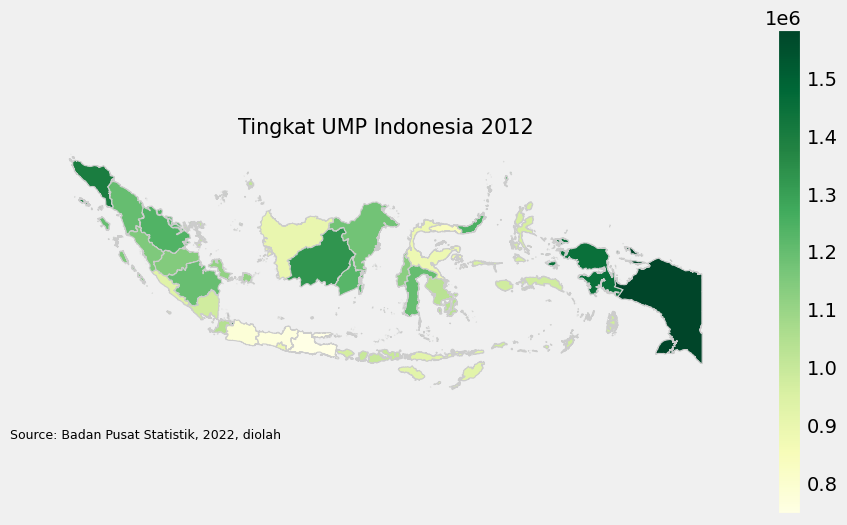

In [56]:
# joining the geodataframe with the cleaned up csv dataframe  2012
merged3 = map_df.set_index('PROVINSI').join(ya_ump.set_index('provinsi'))
#.head() returns the top 5(by default ) lines of the dataframe
merged3.head()
# set a variable that will call whatever column we want to visualise on the map
variable3 = 'ump'
# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(10, 6))
merged3.plot(column=variable3, cmap='YlGn', linewidth=0.8, ax=ax, edgecolor='0.8')
# remove the axis
ax.set_axis_off()
# add a title
plt.title("Tingkat UMP Indonesia 2012",
          fontsize = 15)
# create an annotation for the data source
plt.annotate("Source: Badan Pusat Statistik, 2022, diolah", (0,0), (-20,-20), fontsize=9, 
             xycoords='axes fraction', textcoords='offset points', va='top')
# Create colorbar as a legend
sm3 = plt.cm.ScalarMappable(cmap='YlGn', norm=plt.Normalize(vmin=min(ya_ump.iloc[:,1]), vmax=max(ya_ump.iloc[:,1])))
# empty array for the data range
sm3._A = []
# add the colorbar to the figure
cbar = fig.colorbar(sm3)
#saving our map as .png file.
fig.savefig('map_export.png', dpi=300)

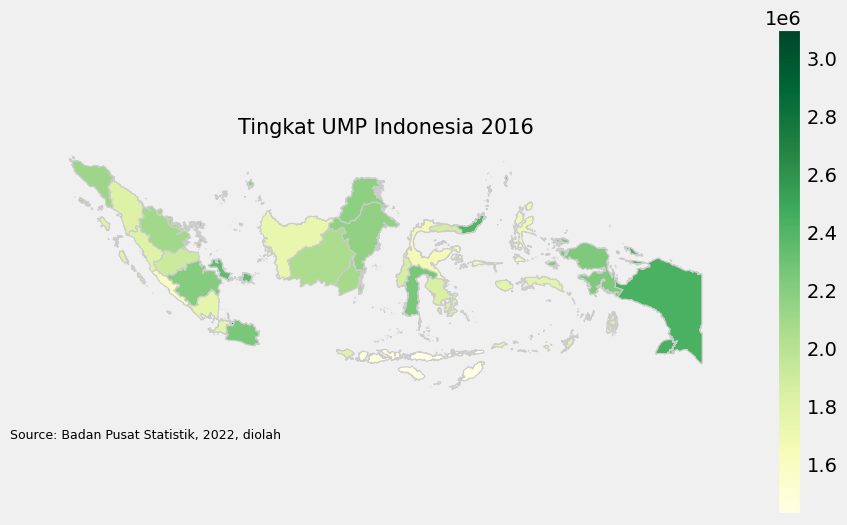

In [57]:
# joining the geodataframe with the cleaned up csv dataframe  2016
merged4 = map_df.set_index('PROVINSI').join(za_ump.set_index('provinsi'))
#.head() returns the top 5(by default ) lines of the dataframe
merged4.head()
# set a variable that will call whatever column we want to visualise on the map
variable4 = 'ump'
# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(10, 6))
merged4.plot(column=variable4, cmap='YlGn', linewidth=0.8, ax=ax, edgecolor='0.8')
# remove the axis
ax.set_axis_off()
# add a title
plt.title("Tingkat UMP Indonesia 2016",
          fontsize = 15)
# create an annotation for the data source
plt.annotate("Source: Badan Pusat Statistik, 2022, diolah", (0,0), (-20,-20), fontsize=9, 
             xycoords='axes fraction', textcoords='offset points', va='top')
# Create colorbar as a legend
sm4 = plt.cm.ScalarMappable(cmap='YlGn', norm=plt.Normalize(vmin=min(za_ump.iloc[:,1]), vmax=max(za_ump.iloc[:,1])))
# empty array for the data range
sm4._A = []
# add the colorbar to the figure
cbar = fig.colorbar(sm4)
#saving our map as .png file.
fig.savefig('map_export.png', dpi=300)

In [58]:
merged4

,OBJECTID,Shape_Leng,Shape_Area,geometry,ump
PROVINSI,,,,,
ACEH,1,27.455786,4.625436,"MULTIPOLYGON Z (((97.39178 2.03748 0.00003, 97...",2118500.0
BALI,2,6.026646,0.458717,"MULTIPOLYGON Z (((115.12509 -8.84761 0.00003, ...",1807600.0
BANTEN,3,9.282228,0.764911,"MULTIPOLYGON Z (((105.54977 -6.99566 0.00003, ...",1784000.0
BENGKULU,4,11.706367,1.630129,"MULTIPOLYGON Z (((102.38616 -5.47144 0.00003, ...",1605000.0
DAERAH ISTIMEWA YOGYAKARTA,5,3.342892,0.260130,"MULTIPOLYGON Z (((110.81980 -8.20358 0.00003, ...",NaN
DKI JAKARTA,6,3.123689,0.053426,"MULTIPOLYGON Z (((106.87677 -6.10030 0.00003, ...",3100000.0
GORONTALO,7,11.013237,0.977600,"MULTIPOLYGON Z (((121.42536 0.41243 0.00003, 1...",1875000.0
JAMBI,8,11.835072,3.977711,"MULTIPOLYGON Z (((104.40714 -0.86371 0.00003, ...",1906650.0
JAWA BARAT,9,11.614950,3.032785,"MULTIPOLYGON Z (((108.68501 -6.76990 0.00003, ...",2250000.0


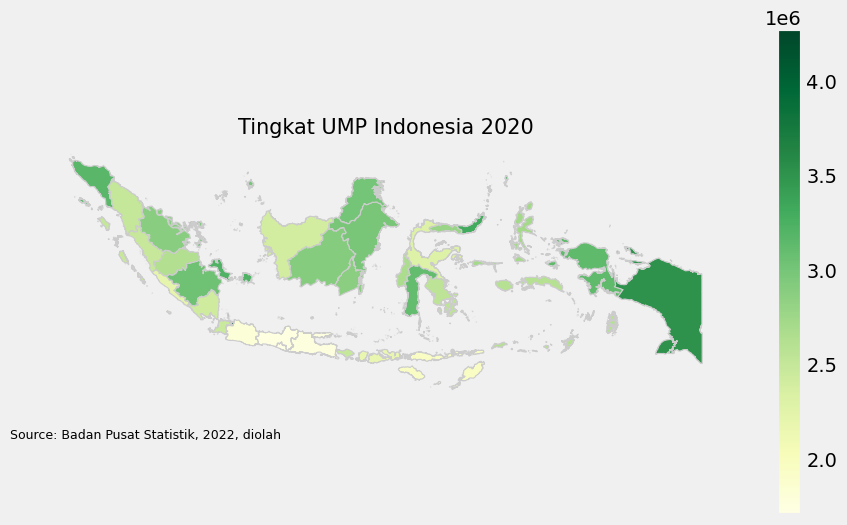

In [59]:
# joining the geodataframe with the cleaned up csv dataframe
merged2 = map_df.set_index('PROVINSI').join(na_ump.set_index('provinsi'))
#.head() returns the top 5(by default ) lines of the dataframe
merged2.head()
# set a variable that will call whatever column we want to visualise on the map
variable2 = 'ump'
# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(10, 6))
merged2.plot(column=variable2, cmap='YlGn', linewidth=0.8, ax=ax, edgecolor='0.8')
# remove the axis
ax.set_axis_off()
# add a title
plt.title("Tingkat UMP Indonesia 2020",
          fontsize = 15)
# create an annotation for the data source
plt.annotate("Source: Badan Pusat Statistik, 2022, diolah", (0,0), (-20,-20), fontsize=9, 
             xycoords='axes fraction', textcoords='offset points', va='top')
# Create colorbar as a legend
sm2 = plt.cm.ScalarMappable(cmap='YlGn', norm=plt.Normalize(vmin=min(na_ump.iloc[:,1]), vmax=max(na_ump.iloc[:,1])))
# empty array for the data range
sm2._A = []
# add the colorbar to the figure
cbar = fig.colorbar(sm2)
#saving our map as .png file.
fig.savefig('map_export.png', dpi=300)

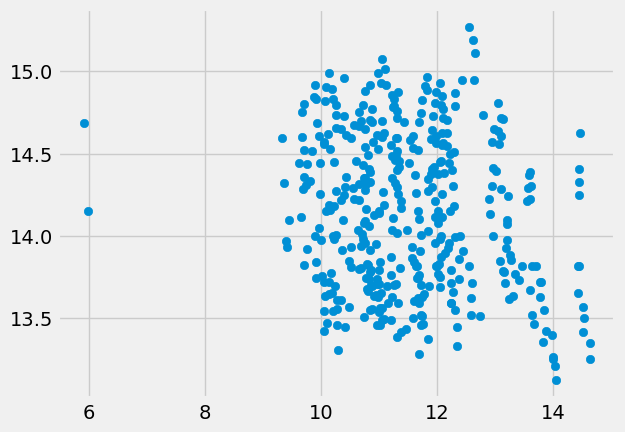

In [60]:
# Modelling regression 
import statsmodels.api as sm
mo = np.log(df.iloc[:, 2])
no = np.log(df.iloc[:, 3])
plt.scatter(mo, no)

In [62]:
dr = pd.read_csv("data_akhir2.csv")

In [64]:
#sk learn regression
from sklearn import preprocessing, svm
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

In [66]:
dr1 = dr.iloc[:, 1:]
dr1

,provinsi,pengangguran,ump,lpengangguran,lump
0,Aceh,163868.0,1000000,12.006817,13.815511
1,Aceh,173624.0,1200000,12.064648,13.997832
2,Aceh,166275.0,1300000,12.021399,14.077875
3,Aceh,178020.0,1350000,12.089651,14.115615
4,Aceh,165707.0,1400000,12.017977,14.151983
...,...,...,...,...,...
393,Sumatera Utara,421232.0,1625000,12.950939,14.301019
394,Sumatera Utara,427964.0,1811875,12.966794,14.409873
395,Sumatera Utara,422921.0,2132189,12.954941,14.572659
396,Sumatera Utara,434342.0,2303403,12.981587,14.649899


  0%|          | 0/889 [00:00<?, ?it/s]

DataPrep Report
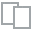
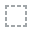
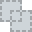
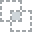
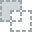
...
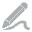
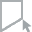
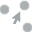
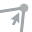
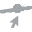

In [67]:
create_report(dr1)

In [86]:
dr2 = dr.loc[dr['tahun']==2008, ]
dr3 = dr.loc[dr['tahun']==2012, ]
dr4 = dr.loc[dr['tahun']==2016, ]
dr5 = dr.loc[dr['tahun']==2020, ]
dr2.describe()

,tahun,pengangguran,ump,lpengangguran,lump
count,33.0,3.300000e+01,3.300000e+01,33.000000,33.000000
mean,2008.0,2.856845e+05,7.566119e+05,11.783960,13.519365
std,0.0,4.670607e+05,1.451992e+05,1.179940,0.187632
min,2008.0,2.714900e+04,5.000000e+05,10.209096,13.122363
25%,2008.0,5.537800e+04,6.700000e+05,10.921938,13.415033
50%,2008.0,1.183740e+05,7.405200e+05,11.681604,13.515108
75%,2008.0,2.303880e+05,8.250000e+05,12.347520,13.623138
max,2008.0,2.262407e+06,1.105500e+06,14.631940,13.915809


In [87]:
dr3.describe()

,tahun,pengangguran,ump,lpengangguran,lump
count,33.0,3.300000e+01,3.300000e+01,33.000000,33.000000
mean,2012.0,2.350858e+05,1.088903e+06,11.507270,13.882275
std,0.0,3.996145e+05,2.142286e+05,1.263912,0.194421
min,2012.0,1.228000e+04,7.450000e+05,9.415728,13.521139
25%,2012.0,4.734300e+04,9.300000e+05,10.765174,13.742940
50%,2012.0,7.985400e+04,1.042000e+06,11.287955,13.856652
75%,2012.0,2.080570e+05,1.200000e+06,12.245567,13.997832
max,2012.0,2.007591e+06,1.585000e+06,14.512446,14.276095


In [88]:
dr4.describe()

,tahun,pengangguran,ump,lpengangguran,lump
count,31.0,3.100000e+01,3.100000e+01,31.000000,31.000000
mean,2016.0,1.730122e+05,1.997819e+06,11.357403,14.494617
std,0.0,3.386962e+05,3.359018e+05,1.086039,0.162041
min,2016.0,1.122800e+04,1.425000e+06,9.326166,14.169683
25%,2016.0,4.652900e+04,1.779500e+06,10.747715,14.391839
50%,2016.0,8.246600e+04,1.906650e+06,11.320142,14.460858
75%,2016.0,1.682365e+05,2.192355e+06,12.031783,14.600467
max,2016.0,1.899707e+06,3.100000e+06,14.457211,14.946913


In [89]:
dr5.describe()

,tahun,pengangguran,ump,lpengangguran,lump
count,34.0,3.400000e+01,3.400000e+01,34.000000,34.000000
mean,2020.0,2.036908e+05,2.672371e+06,11.458085,14.777389
std,0.0,3.561802e+05,5.510253e+05,1.152279,0.210763
min,2020.0,1.649900e+04,1.704608e+06,9.711055,14.348845
25%,2020.0,4.349000e+04,2.407775e+06,10.679239,14.694197
50%,2020.0,7.619750e+04,2.654512e+06,11.241030,14.791729
75%,2020.0,1.681148e+05,3.004296e+06,12.032087,14.915553
max,2020.0,1.889925e+06,4.276350e+06,14.452047,15.268610


{'whiskers': [<matplotlib.lines.Line2D at 0x1a2874d1850>,
 'caps': [<matplotlib.lines.Line2D at 0x1a2a187e850>,
 'boxes': [<matplotlib.lines.Line2D at 0x1a29d5398e0>],
 'medians': [<matplotlib.lines.Line2D at 0x1a29d7e7af0>],
 'fliers': [<matplotlib.lines.Line2D at 0x1a29d7e74f0>],
 'means': []}

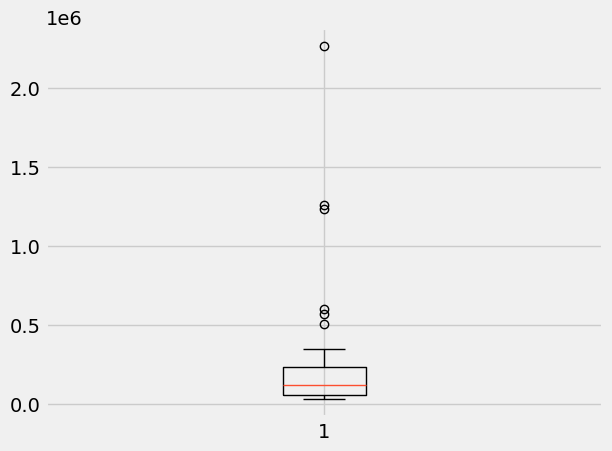

In [78]:
plt.boxplot(dr2.loc[:, 'pengangguran'])

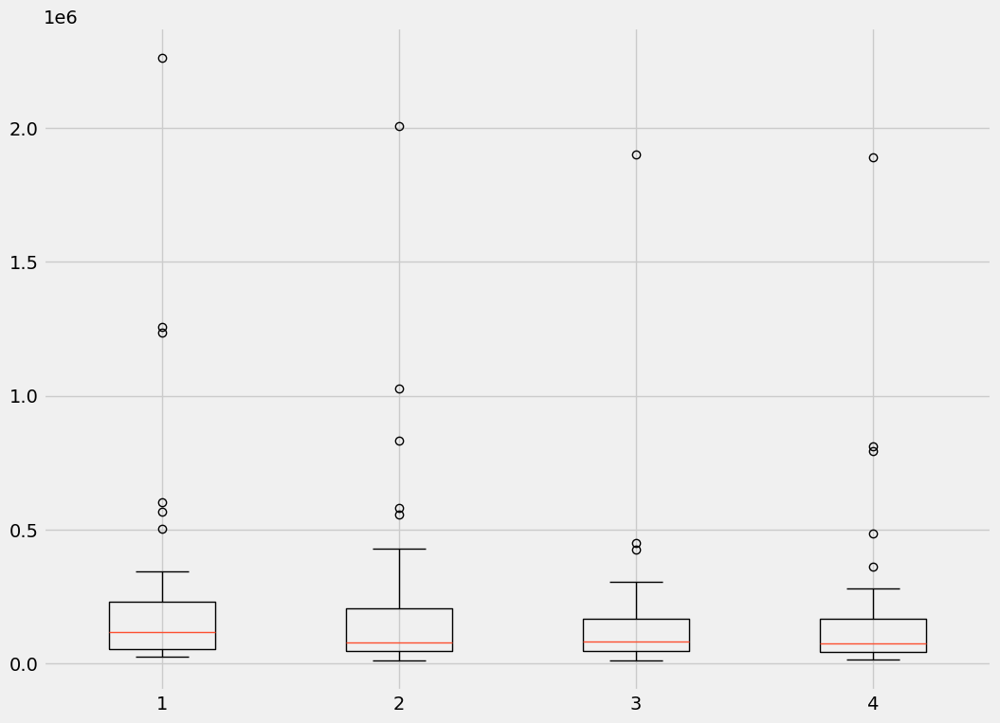

In [81]:
# Creating dataset
np.random.seed(10)

data_1 = dr2.loc[:, 'pengangguran']
data_2 = dr3.loc[:, 'pengangguran']
data_3 = dr4.loc[:, 'pengangguran']
data_4 = dr5.loc[:, 'pengangguran']
data = [data_1, data_2, data_3, data_4]
 
fig = plt.figure(figsize =(10, 7))
 
# Creating axes instance
ax = fig.add_axes([0, 0, 1, 1])
 
# Creating plot
bp = ax.boxplot(data)
 
# show plot
plt.show()

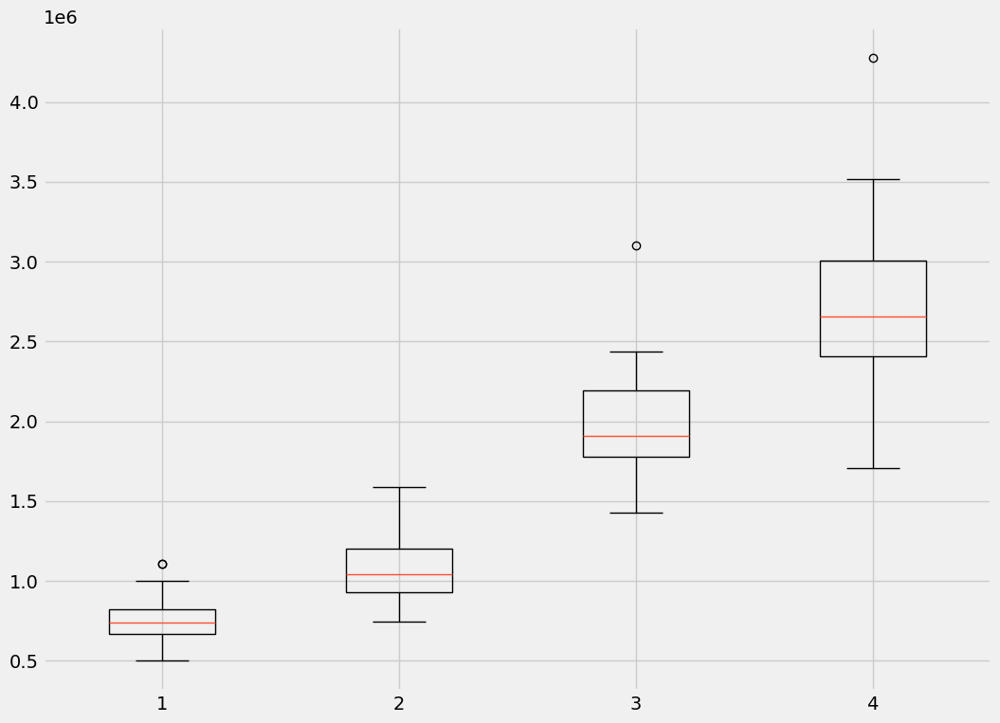

In [82]:
# Creating dataset
np.random.seed(10)

data_1 = dr2.loc[:, 'ump']
data_2 = dr3.loc[:, 'ump']
data_3 = dr4.loc[:, 'ump']
data_4 = dr5.loc[:, 'ump']
data = [data_1, data_2, data_3, data_4]
 
fig = plt.figure(figsize =(10, 7))
 
# Creating axes instance
ax = fig.add_axes([0, 0, 1, 1])
 
# Creating plot
bp = ax.boxplot(data)
 
# show plot
plt.show()

In [90]:
dr.describe()

,tahun,pengangguran,ump,lpengangguran,lump
count,398.000000,3.980000e+02,3.980000e+02,398.000000,398.000000
mean,2013.781407,2.296304e+05,1.545162e+06,11.508073,14.141719
std,3.809038,3.878792e+05,7.294979e+05,1.258071,0.468805
min,2008.000000,3.700417e+02,5.000000e+05,5.913616,13.122363
25%,2011.000000,4.439375e+04,9.282438e+05,10.700821,13.741050
50%,2014.000000,8.246050e+04,1.389518e+06,11.320075,14.144444
75%,2018.000000,1.952572e+05,2.082456e+06,12.182073,14.549056
max,2020.000000,2.262407e+06,4.276350e+06,14.631940,15.268610


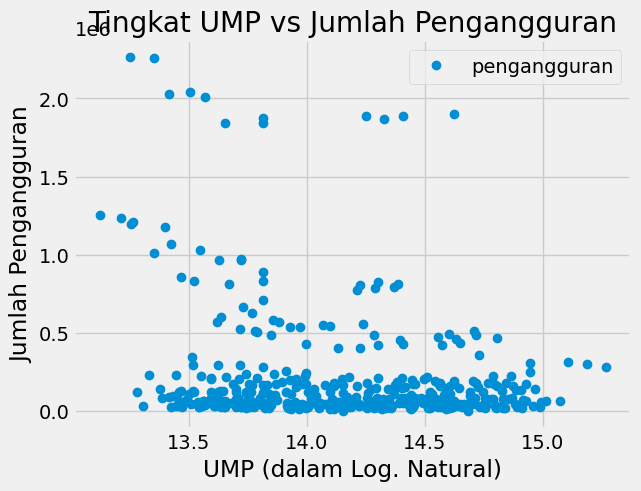

In [96]:
dr.plot(x='lump', y='pengangguran', style='o')
plt.title('Tingkat UMP vs Jumlah Pengangguran')
plt.xlabel('UMP (dalam Log. Natural)')
plt.ylabel('Jumlah Pengangguran')
plt.show()

In [148]:
SEED = 42

In [163]:
# akan dilakukan sklearn
x = dr.iloc[:, -1].values.reshape(-1, 1)
y = dr.iloc[:, 2].values.reshape(-1, 1)
# pembagian data train dan test
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.5, random_state = SEED)

In [182]:
from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(x_train, y_train)
print(regressor.intercept_)

[1964473.29245742]


In [183]:
print(regressor.coef_)

[[-124838.44606412]]


In [166]:
def calc(slope, intercept, lump):
    return slope*lump+intercept

pengangguran = calc(regressor.coef_, regressor.intercept_, 14)
print(pengangguran) # [[94.80663482]]

[[216735.04755968]]


In [167]:
y_pred = regressor.predict(x_test)
df_preds = pd.DataFrame({'Actual': y_test.squeeze(), 'Predicted': y_pred.squeeze()})
print(df_preds)

       Actual      Predicted
0     49156.0  237907.648012
1    434342.0  135602.666301
2     26949.0  113232.865151
3    223486.0  272800.742718
4     20799.0  131308.223756
..        ...            ...
194   54518.0  145781.993193
195   50109.0  209437.491357
196   58098.0  249499.022568
197  160866.0  107342.862427
198  171052.0  160540.768802

[199 rows x 2 columns]


In [172]:
df_preds.head(20)

,Actual,Predicted
0,49156.0,237907.648012
1,434342.0,135602.666301
2,26949.0,113232.865151
3,223486.0,272800.742718
4,20799.0,131308.223756
5,23429.0,288833.244992
6,152267.0,126177.613300
7,19709.0,111729.560583
8,52512.0,242927.027413
9,970617.0,251540.006322


Text(0, 0.5, 'Log. nat UMP')

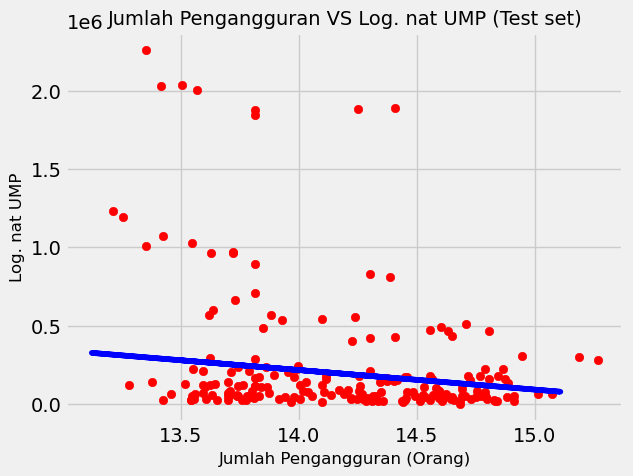

In [175]:
#visualisasi hasil test test
plt.scatter(x_test, y_test, color= 'red')
plt.plot(x_train, regressor.predict(x_train), color='blue')
plt.title('Jumlah Pengangguran VS Log. nat UMP (Test set)', fontsize = 14)
plt.xlabel('Jumlah Pengangguran (Orang)', fontsize = 12)
plt.ylabel('Log. nat UMP', fontsize = 12)

Text(0, 0.5, 'Log. nat UMP')

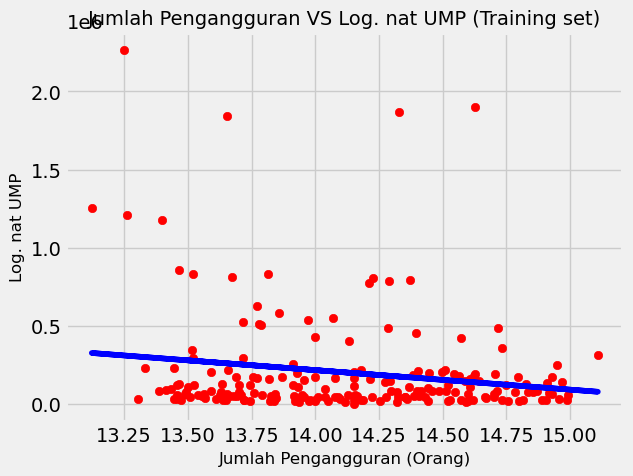

In [176]:
#visualisasi hasil training  test
plt.scatter(x_train, y_train, color= 'red')
plt.plot(x_train, regressor.predict(x_train), color='blue')
plt.title('Jumlah Pengangguran VS Log. nat UMP (Training set)', fontsize = 14)
plt.xlabel('Jumlah Pengangguran (Orang)', fontsize = 12)
plt.ylabel('Log. nat UMP', fontsize = 12)

In [184]:
x_train = sm.add_constant(x_train)
model = sm.OLS(y_train, x_train).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.030
Model:                            OLS   Adj. R-squared:                  0.025
Method:                 Least Squares   F-statistic:                     6.099
Date:                Fri, 09 Dec 2022   Prob (F-statistic):             0.0144
Time:                        01:10:20   Log-Likelihood:                -2813.3
No. Observations:                 199   AIC:                             5631.
Df Residuals:                     197   BIC:                             5637.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       1.964e+06   7.14e+05      2.751      0.0

In [188]:
uji = pd.read_excel('data_uji.xlsx')
print(uji)

     tahun         provinsi pulau  pengangguran      ump  lpengangguran  \
0     2008            Aceh      s      163868.0  1000000      12.006817   
1     2009            Aceh      s      173624.0  1200000      12.064648   
2     2010            Aceh      s      166275.0  1300000      12.021399   
3     2011            Aceh      s      178020.0  1350000      12.089651   
4     2012            Aceh      s      165707.0  1400000      12.017977   
..     ...              ...   ...           ...      ...            ...   
393   2015  Sumatera Utara      s      421232.0  1625000      12.950939   
394   2016  Sumatera Utara      s      427964.0  1811875      12.966794   
395   2018  Sumatera Utara      s      422921.0  2132189      12.954941   
396   2019  Sumatera Utara      s      434342.0  2303403      12.981587   
397   2020  Sumatera Utara      s      360993.0  2499423      12.796614   

          lump     umpt-1    lumpt-1     umpt-2    lumpt-2     umpt-3  \
0    13.815511        NaN 

In [195]:
#klasifikasi sumatera
sumatera = uji.loc[uji['pulau']=='s',]
sumatera = sumatera.iloc[:, [3, 6]]
#klasifikasi jawa
jawa = uji.loc[uji['pulau']=='j',]
jawa = jawa.iloc[:, [3, 6]]
#klasifikasi kalimantan
kalimantan = uji.loc[uji['pulau']=='k',]
kalimantan = kalimantan.iloc[:, [3, 6]]
#klasifikasi kalimantan
sulawesi = uji.loc[uji['pulau']=='sul',]
sulawesi = sulawesi.iloc[:, [3, 6]]
#klasifikasi papua maluku
papua_ma = uji.loc[uji['pulau']=='pm',]
papua_ma = papua_ma.iloc[:, [3, 6]]

In [196]:
sumatera

,pengangguran,lump
0,163868.0,13.815511
1,173624.0,13.997832
2,166275.0,14.077875
3,178020.0,14.115615
4,165707.0,14.151983
...,...,...
393,421232.0,14.301019
394,427964.0,14.409873
395,422921.0,14.572659
396,434342.0,14.649899


In [197]:
#define response variable
y = sumatera.iloc[:, 0]
#define predictor variables
x = sumatera.iloc[:, 1]
#add constant to predictor variables
x = sm.add_constant(x)
#fit linear regression model
model = sm.OLS(y, x).fit()
#view model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:           pengangguran   R-squared:                       0.007
Model:                            OLS   Adj. R-squared:                 -0.002
Method:                 Least Squares   F-statistic:                    0.7911
Date:                Fri, 09 Dec 2022   Prob (F-statistic):              0.376
Time:                        02:11:00   Log-Likelihood:                -1575.6
No. Observations:                 120   AIC:                             3155.
Df Residuals:                     118   BIC:                             3161.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       4.774e+05   3.64e+05      1.312      0.1

In [198]:
#define response variable
y = jawa.iloc[:, 0]
#define predictor variables
x = jawa.iloc[:, 1]
#add constant to predictor variables
x = sm.add_constant(x)
#fit linear regression model
model = sm.OLS(y, x).fit()
#view model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:           pengangguran   R-squared:                       0.104
Model:                            OLS   Adj. R-squared:                  0.091
Method:                 Least Squares   F-statistic:                     7.797
Date:                Fri, 09 Dec 2022   Prob (F-statistic):            0.00681
Time:                        02:14:39   Log-Likelihood:                -1013.5
No. Observations:                  69   AIC:                             2031.
Df Residuals:                      67   BIC:                             2036.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        6.22e+06   1.93e+06      3.225      0.0

In [199]:
#define response variable
y = kalimantan.iloc[:, 0]
#define predictor variables
x = kalimantan.iloc[:, 1]
#add constant to predictor variables
x = sm.add_constant(x)
#fit linear regression model
model = sm.OLS(y, x).fit()
#view model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:           pengangguran   R-squared:                       0.094
Model:                            OLS   Adj. R-squared:                  0.077
Method:                 Least Squares   F-statistic:                     5.319
Date:                Fri, 09 Dec 2022   Prob (F-statistic):             0.0252
Time:                        02:16:32   Log-Likelihood:                -643.11
No. Observations:                  53   AIC:                             1290.
Df Residuals:                      51   BIC:                             1294.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       5.495e+05   1.99e+05      2.759      0.0

In [200]:
#define response variable
y = sulawesi.iloc[:, 0]
#define predictor variables
x = sulawesi.iloc[:, 1]
#add constant to predictor variables
x = sm.add_constant(x)
#fit linear regression model
model = sm.OLS(y, x).fit()
#view model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:           pengangguran   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                 -0.014
Method:                 Least Squares   F-statistic:                   0.05204
Date:                Fri, 09 Dec 2022   Prob (F-statistic):              0.820
Time:                        02:18:32   Log-Likelihood:                -916.54
No. Observations:                  72   AIC:                             1837.
Df Residuals:                      70   BIC:                             1842.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       1.216e+04   2.93e+05      0.041      0.9

In [201]:
#define response variable
y = papua_ma.iloc[:, 0]
#define predictor variables
x = papua_ma.iloc[:, 1]
#add constant to predictor variables
x = sm.add_constant(x)
#fit linear regression model
model = sm.OLS(y, x).fit()
#view model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:           pengangguran   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.021
Method:                 Least Squares   F-statistic:                   0.02198
Date:                Fri, 09 Dec 2022   Prob (F-statistic):              0.883
Time:                        02:20:21   Log-Likelihood:                -529.29
No. Observations:                  48   AIC:                             1063.
Df Residuals:                      46   BIC:                             1066.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.956e+04   7.06e+04      0.419      0.6